# DonorsChoose

<p>
DonorsChoose.org receives hundreds of thousands of project proposals each year for classroom projects in need of funding. Right now, a large number of volunteers is needed to manually screen each submission before it's approved to be posted on the DonorsChoose.org website.
</p>
<p>
    Next year, DonorsChoose.org expects to receive close to 500,000 project proposals. As a result, there are three main problems they need to solve:
<ul>
<li>
    How to scale current manual processes and resources to screen 500,000 projects so that they can be posted as quickly and as efficiently as possible</li>
    <li>How to increase the consistency of project vetting across different volunteers to improve the experience for teachers</li>
    <li>How to focus volunteer time on the applications that need the most assistance</li>
    </ul>
</p>    
<p>
The goal of the competition is to predict whether or not a DonorsChoose.org project proposal submitted by a teacher will be approved, using the text of project descriptions as well as additional metadata about the project, teacher, and school. DonorsChoose.org can then use this information to identify projects most likely to need further review before approval.
</p>

## About the DonorsChoose Data Set

The `train.csv` data set provided by DonorsChoose contains the following features:

Feature | Description 
----------|---------------
**`project_id`** | A unique identifier for the proposed project. **Example:** `p036502`   
**`project_title`**    | Title of the project. **Examples:**<br><ul><li><code>Art Will Make You Happy!</code></li><li><code>First Grade Fun</code></li></ul> 
**`project_grade_category`** | Grade level of students for which the project is targeted. One of the following enumerated values: <br/><ul><li><code>Grades PreK-2</code></li><li><code>Grades 3-5</code></li><li><code>Grades 6-8</code></li><li><code>Grades 9-12</code></li></ul>  
 **`project_subject_categories`** | One or more (comma-separated) subject categories for the project from the following enumerated list of values:  <br/><ul><li><code>Applied Learning</code></li><li><code>Care &amp; Hunger</code></li><li><code>Health &amp; Sports</code></li><li><code>History &amp; Civics</code></li><li><code>Literacy &amp; Language</code></li><li><code>Math &amp; Science</code></li><li><code>Music &amp; The Arts</code></li><li><code>Special Needs</code></li><li><code>Warmth</code></li></ul><br/> **Examples:** <br/><ul><li><code>Music &amp; The Arts</code></li><li><code>Literacy &amp; Language, Math &amp; Science</code></li>  
  **`school_state`** | State where school is located ([Two-letter U.S. postal code](https://en.wikipedia.org/wiki/List_of_U.S._state_abbreviations#Postal_codes)). **Example:** `WY`
**`project_subject_subcategories`** | One or more (comma-separated) subject subcategories for the project. **Examples:** <br/><ul><li><code>Literacy</code></li><li><code>Literature &amp; Writing, Social Sciences</code></li></ul> 
**`project_resource_summary`** | An explanation of the resources needed for the project. **Example:** <br/><ul><li><code>My students need hands on literacy materials to manage sensory needs!</code</li></ul> 
**`project_essay_1`**    | First application essay<sup>*</sup>  
**`project_essay_2`**    | Second application essay<sup>*</sup> 
**`project_essay_3`**    | Third application essay<sup>*</sup> 
**`project_essay_4`**    | Fourth application essay<sup>*</sup> 
**`project_submitted_datetime`** | Datetime when project application was submitted. **Example:** `2016-04-28 12:43:56.245`   
**`teacher_id`** | A unique identifier for the teacher of the proposed project. **Example:** `bdf8baa8fedef6bfeec7ae4ff1c15c56`  
**`teacher_prefix`** | Teacher's title. One of the following enumerated values: <br/><ul><li><code>nan</code></li><li><code>Dr.</code></li><li><code>Mr.</code></li><li><code>Mrs.</code></li><li><code>Ms.</code></li><li><code>Teacher.</code></li></ul>  
**`teacher_number_of_previously_posted_projects`** | Number of project applications previously submitted by the same teacher. **Example:** `2` 

<sup>*</sup> See the section <b>Notes on the Essay Data</b> for more details about these features.

Additionally, the `resources.csv` data set provides more data about the resources required for each project. Each line in this file represents a resource required by a project:

Feature | Description 
----------|---------------
**`id`** | A `project_id` value from the `train.csv` file.  **Example:** `p036502`   
**`description`** | Desciption of the resource. **Example:** `Tenor Saxophone Reeds, Box of 25`   
**`quantity`** | Quantity of the resource required. **Example:** `3`   
**`price`** | Price of the resource required. **Example:** `9.95`   

**Note:** Many projects require multiple resources. The `id` value corresponds to a `project_id` in train.csv, so you use it as a key to retrieve all resources needed for a project:

The data set contains the following label (the value you will attempt to predict):

Label | Description
----------|---------------
`project_is_approved` | A binary flag indicating whether DonorsChoose approved the project. A value of `0` indicates the project was not approved, and a value of `1` indicates the project was approved.

### Notes on the Essay Data

<ul>
Prior to May 17, 2016, the prompts for the essays were as follows:
<li>__project_essay_1:__ "Introduce us to your classroom"</li>
<li>__project_essay_2:__ "Tell us more about your students"</li>
<li>__project_essay_3:__ "Describe how your students will use the materials you're requesting"</li>
<li>__project_essay_3:__ "Close by sharing why your project will make a difference"</li>
</ul>


<ul>
Starting on May 17, 2016, the number of essays was reduced from 4 to 2, and the prompts for the first 2 essays were changed to the following:<br>
<li>__project_essay_1:__ "Describe your students: What makes your students special? Specific details about their background, your neighborhood, and your school are all helpful."</li>
<li>__project_essay_2:__ "About your project: How will these materials make a difference in your students' learning and improve their school lives?"</li>
<br>For all projects with project_submitted_datetime of 2016-05-17 and later, the values of project_essay_3 and project_essay_4 will be NaN.
</ul>


In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer


from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os
from collections import Counter

## 1.1 Reading Data

In [2]:
project_data = pd.read_csv('train_data.csv')
resource_data = pd.read_csv('resources.csv')

In [3]:
print("Number of data points in train data", project_data.shape)
print('-'*50)
print("The attributes of data :", project_data.columns.values)

Number of data points in train data (109248, 17)
--------------------------------------------------
The attributes of data : ['Unnamed: 0' 'id' 'teacher_id' 'teacher_prefix' 'school_state'
 'project_submitted_datetime' 'project_grade_category'
 'project_subject_categories' 'project_subject_subcategories'
 'project_title' 'project_essay_1' 'project_essay_2' 'project_essay_3'
 'project_essay_4' 'project_resource_summary'
 'teacher_number_of_previously_posted_projects' 'project_is_approved']


In [4]:
print("Number of data points in train data", resource_data.shape)
print(resource_data.columns.values)
resource_data.head(2)

Number of data points in train data (1541272, 4)
['id' 'description' 'quantity' 'price']


,id,description,quantity,price
0,p233245,LC652 - Lakeshore Double-Space Mobile Drying Rack,1,149.00
1,p069063,Bouncy Bands for Desks (Blue support pipes),3,14.95


In [5]:
project_cat=[]
for i in range(len(project_data)):
    project_cat.append(project_data['project_grade_category'][i].replace(" ","_"))

In [6]:
project_data['project_grade_category']=project_cat

## 1.2 preprocessing of `project_subject_categories`

In [7]:
catogories = list(project_data['project_subject_categories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    
project_data['clean_categories'] = cat_list
clean_cat=[]
for i in range(len(project_data)):
    clean_cat.append(project_data['clean_categories'][i].replace(" ","_"))

project_data.drop(['project_subject_categories'], axis=1, inplace=True)

project_data['clean_categories']=clean_cat    
from collections import Counter
my_counter = Counter()
for word in project_data['clean_categories'].values:
    my_counter.update(word.split())

cat_dict = dict(my_counter)
sorted_cat_dict = dict(sorted(cat_dict.items(), key=lambda kv: kv[1]))


## 1.3 preprocessing of `project_subject_subcategories`

In [8]:
sub_catogories = list(project_data['project_subject_subcategories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

sub_cat_list = []
for i in sub_catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp +=j.strip()+" "#" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_')
    sub_cat_list.append(temp.strip())

project_data['clean_subcategories'] = sub_cat_list
clean_subcat=[]
for i in range(len(project_data)):
    clean_subcat.append(project_data['clean_subcategories'][i].replace(" ","_"))
project_data['clean_subcategories']=clean_subcat

project_data.drop(['project_subject_subcategories'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_subcategories'].values:
    my_counter.update(word.split())
    
sub_cat_dict = dict(my_counter)
sorted_sub_cat_dict = dict(sorted(sub_cat_dict.items(), key=lambda kv: kv[1]))

## 1.3 Text preprocessing

In [9]:
# merge two column text dataframe: 
project_data["essay"] = project_data["project_essay_1"].map(str) +\
                        project_data["project_essay_2"].map(str) + \
                        project_data["project_essay_3"].map(str) + \
                        project_data["project_essay_4"].map(str)

In [10]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,project_submitted_datetime,project_grade_category,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,Mrs.,IN,2016-12-05 13:43:57,Grades_PreK-2,Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,My students need opportunities to practice beg...,0,0,Literacy_Language,ESL_Literacy,My students are English learners that are work...
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,Mr.,FL,2016-10-25 09:22:10,Grades_6-8,Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,My students need a projector to help with view...,7,1,History_Civics_Health_Sports,Civics_Government_TeamSports,Our students arrive to our school eager to lea...


In [11]:
#### 1.4.2.3 Using Pretrained Models: TFIDF weighted W2V

In [12]:
# printing some random reviews
print(project_data['essay'].values[0])
print("="*50)
print(project_data['essay'].values[150])
print("="*50)
print(project_data['essay'].values[1000])
print("="*50)
print(project_data['essay'].values[20000])
print("="*50)
print(project_data['essay'].values[99999])
print("="*50)

My students are English learners that are working on English as their second or third languages. We are a melting pot of refugees, immigrants, and native-born Americans bringing the gift of language to our school. \r\n\r\n We have over 24 languages represented in our English Learner program with students at every level of mastery.  We also have over 40 countries represented with the families within our school.  Each student brings a wealth of knowledge and experiences to us that open our eyes to new cultures, beliefs, and respect.\"The limits of your language are the limits of your world.\"-Ludwig Wittgenstein  Our English learner's have a strong support system at home that begs for more resources.  Many times our parents are learning to read and speak English along side of their children.  Sometimes this creates barriers for parents to be able to help their child learn phonetics, letter recognition, and other reading skills.\r\n\r\nBy providing these dvd's and players, students are ab

In [13]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [14]:
sent = decontracted(project_data['essay'].values[20000])
print(sent)
print("="*50)

My kindergarten students have varied disabilities ranging from speech and language delays, cognitive delays, gross/fine motor delays, to autism. They are eager beavers and always strive to work their hardest working past their limitations. \r\n\r\nThe materials we have are the ones I seek out for my students. I teach in a Title I school where most of the students receive free or reduced price lunch.  Despite their disabilities and limitations, my students love coming to school and come eager to learn and explore.Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting? This is how my kids feel all the time. The want to be able to move as they learn or so they say.Wobble chairs are the answer and I love then because they develop their core, which enhances gross motor and in Turn fine motor skills. \r\nThey also want to learn through games, my kids do not want to sit and do worksheets. They want to learn to count by jumping and playing

In [15]:
# \r \n \t remove from string python: http://texthandler.com/info/remove-line-breaks-python/
sent = sent.replace('\\r', ' ')
sent = sent.replace('\\"', ' ')
sent = sent.replace('\\n', ' ')
print(sent)

My kindergarten students have varied disabilities ranging from speech and language delays, cognitive delays, gross/fine motor delays, to autism. They are eager beavers and always strive to work their hardest working past their limitations.     The materials we have are the ones I seek out for my students. I teach in a Title I school where most of the students receive free or reduced price lunch.  Despite their disabilities and limitations, my students love coming to school and come eager to learn and explore.Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting? This is how my kids feel all the time. The want to be able to move as they learn or so they say.Wobble chairs are the answer and I love then because they develop their core, which enhances gross motor and in Turn fine motor skills.   They also want to learn through games, my kids do not want to sit and do worksheets. They want to learn to count by jumping and playing. Phys

In [16]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
print(sent)

My kindergarten students have varied disabilities ranging from speech and language delays cognitive delays gross fine motor delays to autism They are eager beavers and always strive to work their hardest working past their limitations The materials we have are the ones I seek out for my students I teach in a Title I school where most of the students receive free or reduced price lunch Despite their disabilities and limitations my students love coming to school and come eager to learn and explore Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting This is how my kids feel all the time The want to be able to move as they learn or so they say Wobble chairs are the answer and I love then because they develop their core which enhances gross motor and in Turn fine motor skills They also want to learn through games my kids do not want to sit and do worksheets They want to learn to count by jumping and playing Physical engagement is the

In [17]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [18]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_essays = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['essay'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e not in stopwords)
    preprocessed_essays.append(sent.lower().strip())

100%|██████████| 109248/109248 [00:59<00:00, 1842.56it/s]


In [19]:
# after preprocesing
preprocessed_essays[20000]

'my kindergarten students varied disabilities ranging speech language delays cognitive delays gross fine motor delays autism they eager beavers always strive work hardest working past limitations the materials ones i seek students i teach title i school students receive free reduced price lunch despite disabilities limitations students love coming school come eager learn explore have ever felt like ants pants needed groove move meeting this kids feel time the want able move learn say wobble chairs answer i love develop core enhances gross motor turn fine motor skills they also want learn games kids not want sit worksheets they want learn count jumping playing physical engagement key success the number toss color shape mats make happen my students forget work fun 6 year old deserves nannan'

<h2><font color='red'> 1.4 Preprocessing of `project_title`</font></h2>

In [20]:
# similarly you can preprocess the titles also
project_title=project_data['project_title']
import re
preprocessed_title=[]
for i in project_title:
    i=i.replace('\\r',"")
    i=i.replace('\\n',"")
    i=i.replace('\\t',"")
    i=i.replace("'\'","")
    i=i.replace(":","")
    i=i.replace("'","")
    i=i.replace("-","")
    i=i.replace(",","")
    i=i.replace(".","")
    i=i.replace("'""'","")
    clean=re.sub('[^A-Za-z0-9]+'," ",i)
    word = ' '.join(e for e in clean.split() if e not in stopwords)
    preprocessed_title.append(word.lower().strip())

In [21]:
#https://simmonhessner.de/lammitize-whole-sentences-with-python-and-nltks-wordnetlemmatizer/
#lemmatizing the preprocessed_title
from nltk.stem import *
import nltk
from nltk.corpus import wordnet
lemmatizer=WordNetLemmatizer()
def nltk2wn_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:
        return None
def lemmatize_sentence(sentence):
    nltk_tagged=nltk.pos_tag(nltk.word_tokenize(sentence))
    wn_tagged=map(lambda x:(x[0],nltk2wn_tag(x[1])),nltk_tagged)
    res_words=[]
    for word,tag in wn_tagged:
        if tag is None:
            res_words.append(word)
        else:
            res_words.append(lemmatizer.lemmatize(word,tag))
    return " ".join(res_words)
from tqdm import tqdm
clean_title=[]
for word in tqdm(preprocessed_title):
    i=lemmatize_sentence(word)
    clean_title.append(i)

100%|██████████| 109248/109248 [01:40<00:00, 1085.89it/s]


In [22]:
num_counter=[]
project_sumry=project_data['project_resource_summary'].str.split()
for i,sent in enumerate(project_sumry):
    for word in sent:
        if word.isdigit():
            num_counter.append(i)
numerical_digit=[]
for sent_i in range(len(project_sumry)):
    if sent_i in num_counter:
        numerical_digit.append(1)
    else:
        numerical_digit.append(0)
print(numerical_digit[4:20])
print(len(numerical_digit))


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1]
109248


In [23]:
project_data.shape
project_data['project_sumry_digit']=numerical_digit

In [24]:
project_data['essay']= preprocessed_essays
essay_word_count = project_data['essay'].str.split().apply(len)
essay_word_count = essay_word_count.values
print(len(essay_word_count))

109248


In [25]:
project_data['title']= preprocessed_title
title_word_count = project_data['title'].str.split().apply(len)
title_word_count = title_word_count.values
print(len(title_word_count))

109248


In [26]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')
project_data['title_Count']=title_word_count
project_data['essay_Count']=essay_word_count

## 1.5 Preparing data for models

In [27]:
project_data.columns

Index(['Unnamed: 0', 'id', 'teacher_id', 'teacher_prefix', 'school_state',
       'project_submitted_datetime', 'project_grade_category', 'project_title',
       'project_essay_1', 'project_essay_2', 'project_essay_3',
       'project_essay_4', 'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'essay',
       'project_sumry_digit', 'title', 'price', 'quantity', 'title_Count',
       'essay_Count'],
      dtype='object')

we are going to consider

       - school_state : categorical data
       - clean_categories : categorical data
       - clean_subcategories : categorical data
       - project_grade_category : categorical data
       - teacher_prefix : categorical data
       
       - project_title : text data
       - text : text data
       - project_resource_summary: text data (optinal)
       
       - quantity : numerical (optinal)
       - teacher_number_of_previously_posted_projects : numerical
       - price : numerical

__ Computing Sentiment Scores__

In [28]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# import nltk
# nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

sentiment_com_essay=[]
sentiment_neg_essay=[]
sentiment_pos_essay=[]
for for_sentiment in tqdm(project_data['essay']):
    ss = sid.polarity_scores(for_sentiment)
    sentiment_com_essay.append(ss['compound'])
    sentiment_neg_essay.append(ss['neg'])
    sentiment_pos_essay.append(ss['pos'])
project_data['com_essay']=sentiment_com_essay
project_data['neg_essay']=sentiment_neg_essay
project_data['pos_essay']=sentiment_pos_essay

C:\ProgramData\Anaconda\lib\site-packages\nltk\twitter\__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "
100%|██████████| 109248/109248 [03:29<00:00, 521.46it/s]


<h1>2. Random Forest and GBDT </h1>

<h2>2.1 Splitting data into Train and cross validation(or test): Stratified Sampling</h2>

In [29]:

from sklearn.model_selection import train_test_split
project_data=project_data[['teacher_prefix', 'school_state', 'project_grade_category', 'project_resource_summary',
       'teacher_number_of_previously_posted_projects',
       'clean_categories', 'clean_subcategories', 'essay', 'price', 'quantity','project_is_approved','project_sumry_digit'
                          , 'title_Count', 'essay_Count','title','com_essay','neg_essay','pos_essay']]
project_data=project_data.dropna()
y=project_data['project_is_approved']
x=project_data[['teacher_prefix', 'school_state', 'project_grade_category', 'title', 'project_resource_summary',
       'teacher_number_of_previously_posted_projects',
       'clean_categories', 'clean_subcategories', 'essay', 'price', 'quantity','project_sumry_digit'
                          , 'title_Count', 'essay_Count','com_essay','neg_essay','pos_essay']]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=0)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
print(x_train.columns)

(76471, 17)
(76471,)
(32774, 17)
(32774,)
Index(['teacher_prefix', 'school_state', 'project_grade_category', 'title',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'clean_categories',
       'clean_subcategories', 'essay', 'price', 'quantity',
       'project_sumry_digit', 'title_Count', 'essay_Count', 'com_essay',
       'neg_essay', 'pos_essay'],
      dtype='object')


In [30]:
 my_counter=Counter()
for grade in x_train['school_state'].values:
    my_counter.update(grade.split())
dict_my_counter=dict(my_counter)
sort_project_grade_cat=dict(sorted(dict_my_counter.items(), key=lambda kv: kv[1]))
vectorizer = CountVectorizer(vocabulary=list(sort_project_grade_cat),lowercase=False, binary=True)
vectorizer.fit(x_train['school_state'])
    # vectorizing 
school_state_one_hot_train = vectorizer.transform(x_train['school_state'])
school_state_one_hot_test  = vectorizer.transform(x_test['school_state'])
school_state_feature_name  = vectorizer.get_feature_names()

In [31]:
my_counter=Counter()
for grade in x_train['clean_categories'].values:
    my_counter.update(grade.split())
dict_my_counter=dict(my_counter)
sorted_sub_cat_dict=dict(sorted(dict_my_counter.items(), key=lambda kv: kv[1]))
vectorizer = CountVectorizer(vocabulary=list(sorted_sub_cat_dict.keys()),\
lowercase=False, binary= True) 
vectorizer.fit(x_train['clean_categories'].values)

categories_one_hot_train=vectorizer.transform(x_train['clean_categories'].values)
categories_one_hot_test=vectorizer.transform(x_test['clean_categories'].values)
categories_feature_name=vectorizer.get_feature_names()

In [32]:
my_counter=Counter()
for grade in x_train['clean_subcategories'].values:
    my_counter.update(grade.split())
dict_my_counter=dict(my_counter)
sorted_sub_cat_dict=dict(sorted(dict_my_counter.items(), key=lambda kv: kv[1]))
vectorizer = CountVectorizer(vocabulary=list(sorted_sub_cat_dict.keys()),\
lowercase=False, binary= True) 
vectorizer.fit(x_train['clean_subcategories'].values)


subcategories_one_hot_train=vectorizer.transform(x_train['clean_subcategories'])
subcategories_one_hot_test=vectorizer.transform(x_test['clean_subcategories'])
subcategories_feature_name=vectorizer.get_feature_names()

In [33]:
my_counter=Counter()
for grade in x_train['teacher_prefix'].values:
    my_counter.update(grade.split())
dict_my_counter=dict(my_counter)
sorted_sub_cat_dict=dict(sorted(dict_my_counter.items(), key=lambda kv: kv[1]))
vectorizer = CountVectorizer(vocabulary=list(sorted_sub_cat_dict.keys()),\
lowercase=False, binary= True) 
vectorizer.fit(x_train['teacher_prefix'].values)

teacher_prefix_one_hot_train=vectorizer.transform(x_train['teacher_prefix'])
teacher_prefix_one_hot_test=vectorizer.transform(x_test['teacher_prefix'])
teacher_pre_feature_name=vectorizer.get_feature_names()

In [34]:
from sklearn.preprocessing import Normalizer
normalizer=Normalizer()
normalizer.fit(x_train['price'].values.reshape(-1,1))
price_one_hot_train = normalizer.transform(x_train['price'].values.reshape(-1,1)) 
price_one_hot_test = normalizer.transform(x_test['price'].values.reshape(-1,1)) 
normalizer.fit(x_train['quantity'].values.reshape(-1,1))
quantity_one_hot_train=normalizer.transform(x_train['quantity'].values.reshape(-1,1))
quantity_one_hot_test=normalizer.transform(x_test['quantity'].values.reshape(-1,1))

In [35]:
my_counter=Counter()
for grade in x_train['project_grade_category'].values:
    my_counter.update(grade.split())
dict_my_counter=dict(my_counter)
sorted_sub_cat_dict=dict(sorted(dict_my_counter.items(), key=lambda kv: kv[1]))
vectorizer = CountVectorizer(vocabulary=list(sorted_sub_cat_dict.keys()),\
lowercase=False, binary= True) 
vectorizer.fit(x_train['project_grade_category'].values)

grade_cat_one_hot_train=vectorizer.transform(x_train['project_grade_category'])
grade_cat_one_hot_test=vectorizer.transform(x_test['project_grade_category'])
grade_feature_name= vectorizer.get_feature_names()

In [36]:
print(school_state_one_hot_train.shape)
print(school_state_one_hot_test.shape)
print(quantity_one_hot_train.shape)
print(quantity_one_hot_test.shape)
print(price_one_hot_train.shape)
print(price_one_hot_test.shape)

print(subcategories_one_hot_train.shape)
print(subcategories_one_hot_test.shape)
print(categories_one_hot_train.shape)
print(categories_one_hot_test.shape)
print(grade_cat_one_hot_train.shape)
print(grade_cat_one_hot_test.shape)
print(teacher_prefix_one_hot_train.shape)
print(teacher_prefix_one_hot_test.shape)

(76471, 51)
(32774, 51)
(76471, 1)
(32774, 1)
(76471, 1)
(32774, 1)
(76471, 394)
(32774, 394)
(76471, 50)
(32774, 50)
(76471, 4)
(32774, 4)
(76471, 5)
(32774, 5)


In [37]:
num_or_not_train=x_train['project_sumry_digit'].values.reshape(-1,1)
num_or_not_test=x_test['project_sumry_digit'].values.reshape(-1,1)
num_or_not_train.shape

(76471, 1)

In [38]:
essay_count_train=x_train['essay_Count'].values.reshape(-1,1)
essay_count_test=x_test['essay_Count'].values.reshape(-1,1)
essay_count_train.shape

(76471, 1)

In [39]:
title_count_train=x_train['title_Count'].values.reshape(-1,1)
title_count_test=x_test['title_Count'].values.reshape(-1,1)
title_count_train.shape

(76471, 1)

<h2>2.2 Make Data Model Ready: encoding numerical, categorical features</h2>

In [34]:

import scipy
train=scipy.sparse.csr_matrix(y_train)
test=scipy.sparse.csr_matrix(y_test)
scipy.sparse.save_npz('y_train.npz', train)
scipy.sparse.save_npz('y_test.npz',test)

In [36]:
train=scipy.sparse.load_npz('y_train.npz')

In [41]:
x_train['project_approved']=y_train

In [42]:
def response_encoding(feature,data):
    """Response encoding of Features"""
    feature_pos=x_train[x_train['project_approved']==1][feature] #training particular feature by only taking train data
    feature_neg=x_train[x_train['project_approved']==0][feature]
    my_counter=Counter()
    for value in feature_pos:
        my_counter.update(value.split())
    feature_pos_dict=dict(my_counter)
    my_counter=Counter()
    for value in feature_neg:
        my_counter.update(value.split())
    feature_neg_dict=dict(my_counter)
    pos_prob={}
    neg_prob={}
    for value in feature_neg_dict.keys():
        if value is not feature_pos_dict:
            neg_prob[value]=0.5                      #Assigning probability to postitive and negative feature of train data
            continue
        neg_prob[value]=(feature_neg_dict[value]/(feature_neg_dict[value]+feature_pos_dict[value]))
    for value in feature_pos_dict.keys():
        if value is not feature_neg_dict:
            pos_prob[value]=0.5
            continue
        pos_prob[value]=(feature_pos_dict[value]/(feature_neg_dict[value]+feature_pos_dict[value]))
    pos_state=[]
    neg_state=[]
    for value in data[feature].values:    # Required train or test 
        if value in pos_prob:              #Now checking probability with train data only
            pos_state.append(pos_prob[value])
        else:
            pos_state.append(0.5)
        if value in neg_prob:
            neg_state.append(neg_prob[value])
        else:
            neg_state.append(0.05)
    return pos_state,neg_state

#Response Encoding of State feature

In [43]:
state_1,state_0=response_encoding('school_state',x_train) #for train
x_train['state_1']=state_1
x_train['state_0']=state_0

In [44]:
state1,state_0=response_encoding('school_state',x_test)  #for test
x_test['state_1']=state1
x_test['state_0']=state1

# Response encoding of Grade state

In [45]:
state1,state0=response_encoding('project_grade_category',x_train) 

In [46]:
x_train['grade_state1']=state1
x_train['grade_state0']=state0

In [47]:
state1,state0=response_encoding('project_grade_category',x_test)

In [48]:
x_test['grade_state1']=state1
x_test['grade_state0']=state0

# Response encoding of Teacher prefix feature

In [49]:
state1,state0=response_encoding('teacher_prefix',x_train)
x_train['prefix_state1']=state1
x_train['prefix_state0']=state0

In [50]:
state1,state0=response_encoding('teacher_prefix',x_test)
x_test['prefix_state1']=state1
x_test['prefix_state0']=state0

# Response encoding of Categories feature

In [51]:
state1,state0=response_encoding('clean_categories',x_train)
x_train['cat_state1'] = state1
x_train['cat_state0'] = state0

In [52]:
state1,state0=response_encoding('clean_categories',x_test)
x_test['cat_state1'] = state1
x_test['cat_state0'] = state0

# Response encoding of Subcategories features

In [53]:
state1,state0=response_encoding('clean_subcategories',x_train)
x_train['subcat_state1'] = state1
x_train['subcat_state0'] = state0

In [54]:
state1,state0=response_encoding('clean_subcategories',x_test)
x_test['subcat_state1'] = state1
x_test['subcat_state0'] = state0
print(x_test['subcat_state1'].shape)

(32774,)


# Normallize the Response encoding feature

In [55]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['state_1'].values.reshape(-1,1))
state_1=norm.transform(x_train['state_1'].values.reshape(-1,1))
x_train['state_1']=state_1
state_1=norm.transform(x_test['state_1'].values.reshape(-1,1))
x_test['state_1']=state_1

In [56]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['state_0'].values.reshape(-1,1))
state_1=norm.transform(x_train['state_0'].values.reshape(-1,1))
x_train['state_0']=state_1
state_1=norm.transform(x_test['state_0'].values.reshape(-1,1))
x_test['state_0']=state_1


In [57]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['grade_state1'].values.reshape(-1,1))
state_1=norm.transform(x_train['grade_state1'].values.reshape(-1,1))
x_train['grade_state1']=state_1
state_1=norm.transform(x_test['grade_state1'].values.reshape(-1,1))
x_test['grade_state1']=state_1


In [58]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['grade_state0'].values.reshape(-1,1))
state_1=norm.transform(x_train['grade_state0'].values.reshape(-1,1))
x_train['grade_state0']=state_1
state_1=norm.transform(x_test['grade_state0'].values.reshape(-1,1))
x_test['grade_state0']=state_1


In [59]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['prefix_state1'].values.reshape(-1,1))
state_1=norm.transform(x_train['prefix_state1'].values.reshape(-1,1))
x_train['prefix_state1']=state_1
state_1=norm.transform(x_test['prefix_state1'].values.reshape(-1,1))
x_test['prefix_state1']=state_1


In [60]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['prefix_state0'].values.reshape(-1,1))
state_1=norm.transform(x_train['prefix_state0'].values.reshape(-1,1))
x_train['prefix_state0']=state_1
state_1=norm.transform(x_test['prefix_state0'].values.reshape(-1,1))
x_test['prefix_state0']=state_1


In [61]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['cat_state1'].values.reshape(-1,1))
state_1=norm.transform(x_train['cat_state1'].values.reshape(-1,1))
x_train['cat_state1']=state_1
state_1=norm.transform(x_test['cat_state1'].values.reshape(-1,1))
x_test['cat_state1']=state_1


In [62]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['cat_state0'].values.reshape(-1,1))
state_1=norm.transform(x_train['cat_state0'].values.reshape(-1,1))
x_train['cat_state0']=state_1
state_1=norm.transform(x_test['cat_state0'].values.reshape(-1,1))
x_test['cat_state0']=state_1

In [63]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['subcat_state1'].values.reshape(-1,1))
state_1=norm.transform(x_train['subcat_state1'].values.reshape(-1,1))
x_train['subcat_state1']=state_1
state_1=norm.transform(x_test['subcat_state1'].values.reshape(-1,1))
x_test['subcat_state1']=state_1


In [64]:
from sklearn.preprocessing import Normalizer
norm=Normalizer()
norm.fit(x_train['subcat_state0'].values.reshape(-1,1))
state_1=norm.transform(x_train['subcat_state0'].values.reshape(-1,1))
x_train['subcat_state0']=state_1
state_1=norm.transform(x_test['subcat_state0'].values.reshape(-1,1))
x_test['subcat_state0']=state_1

<h2>2.3 Make Data Model Ready: encoding eassay, and project_title</h2>

In [66]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(min_df=10)
def bow(data): 
    text_bow = vectorizer.transform(data)
    return text_bow
vectorizer.fit(x_train['essay'])
bow_train_essay  = bow(x_train['essay'])
bow_test_essay   = bow(x_test['essay'])
bow_essay_feature_name = vectorizer.get_feature_names()
#bow of v
vectorizer.fit(x_train['title'])
bow_train_title=bow(x_train['title'])
bow_test_title=bow(x_test['title'])
bow_title_feature_name = vectorizer.get_feature_names()

In [67]:

print(bow_train_title.shape)
print(bow_test_title.shape)
print(bow_train_essay.shape)
print(bow_test_essay.shape)

(76471, 2708)
(32774, 2708)
(76471, 14453)
(32774, 14453)


In [68]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer()
vectorizer = TfidfVectorizer(min_df=10)
vectorizer.fit(x_train['essay'])
tfidf_train_essay = vectorizer.transform(x_train['essay'])
tfidf_test_essay = vectorizer.transform(x_test['essay'])
tfidf_essay_feature= vectorizer.get_feature_names()
print(tfidf_train_essay.shape)
print(tfidf_test_essay.shape)


(76471, 14453)
(32774, 14453)


In [69]:
vectorizer.fit(x_train['title'])
tfidf_train_title = vectorizer.transform(x_train['title'])
tfidf_test_title = vectorizer.transform(x_test['title'])
tfidf_title_feature = vectorizer.get_feature_names()
print(tfidf_train_title.shape)
print(tfidf_test_title.shape)


(76471, 2708)
(32774, 2708)


In [70]:
# average Word2Vec
# compute average word2vec for each review.
def avg_w2v(data):
    with open('glove_vectors', 'rb') as f:
        model = pickle.load(f)
        glove_words =  set(model.keys())
    avg_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
    for sentence in data: # for each review/sentence
        vector = np.zeros(300) # as word vectors are of zero length
        cnt_words =0; # num of words with a valid vector in the sentence/review
        for word in sentence.split(): # for each word in a review/sentence
            if word in glove_words:
                vector += model[word]
                cnt_words += 1
        if cnt_words != 0:
            vector /= cnt_words
        avg_w2v_vectors.append(vector)
    return avg_w2v_vectors



# average Word2Vec
# compute average word2vec for each review
def tfidf_weighted_w2v(data,tfidf_words):
    with open('glove_vectors', 'rb') as f:
        model = pickle.load(f)
        glove_words =  set(model.keys())
    tfidf_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
    for sentence in data: # for each review/sentence
        vector = np.zeros(300) # as word vectors are of zero length
        tf_idf_weight =0; # num of words with a valid vector in the sentence/review
        for word in sentence.split(): # for each word in a review/sentence
            if (word in glove_words) and (word in tfidf_words):
                vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
                tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
                vector += (vec * tf_idf) # calculating tfidf weighted w2v
                tf_idf_weight += tf_idf
        if tf_idf_weight != 0:
            vector /= tf_idf_weight
        tfidf_w2v_vectors.append(vector)
    return tfidf_w2v_vectors

In [71]:
avgw2v_train_essay=avg_w2v(x_train['essay'])
avgw2v_test_essay=avg_w2v(x_test['essay'])
avgw2v_train_title=avg_w2v(x_train['title'])
avgw2v_test_title=avg_w2v(x_test['title'])


tfidf_model = TfidfVectorizer()
tfidf_model.fit(x_train['essay'])# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())
wtw2v_train_essay=tfidf_weighted_w2v(x_train['essay'],tfidf_words)
wtw2v_test_essay=tfidf_weighted_w2v(x_test['essay'],tfidf_words)


tfidf_model = TfidfVectorizer()
tfidf_model.fit(x_train['title'])# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())
wtw2v_train_title=tfidf_weighted_w2v(x_train['title'],tfidf_words)
wtw2v_test_title=tfidf_weighted_w2v(x_test['title'],tfidf_words)

In [72]:
print(len(avgw2v_train_title),len(avgw2v_train_title[0]))

76471 300


In [73]:
pos_train_essay=x_train['pos_essay'].values.reshape(-1,1)
neg_train_essay=x_train['neg_essay'].values.reshape(-1,1)
com_train_essay=x_train['com_essay'].values.reshape(-1,1)
pos_test_essay=x_test['pos_essay'].values.reshape(-1,1)
neg_test_essay=x_test['neg_essay'].values.reshape(-1,1)
com_test_essay=x_test['com_essay'].values.reshape(-1,1)

In [74]:
state_pos_train = x_train['state_1'].values.reshape(-1,1)
state_pos_test = x_test['state_1'].values.reshape(-1,1)

state_neg_train = x_train['state_0'].values.reshape(-1,1)
state_neg_test = x_test['state_0'].values.reshape(-1,1)


In [75]:
grade_pos_train = x_train['grade_state1'].values.reshape(-1,1)
grade_pos_test = x_test['grade_state1'].values.reshape(-1,1)

grade_neg_train = x_train['grade_state0'].values.reshape(-1,1)
grade_neg_test = x_test['grade_state0'].values.reshape(-1,1)


In [76]:
prefix_pos_train = x_train['prefix_state1'].values.reshape(-1,1)
prefix_pos_test = x_test['prefix_state1'].values.reshape(-1,1)

prefix_neg_train = x_train['prefix_state0'].values.reshape(-1,1)
prefix_neg_test = x_test['prefix_state0'].values.reshape(-1,1)


In [77]:
cat_pos_train = x_train['cat_state1'].values.reshape(-1,1)
cat_pos_test = x_test['cat_state1'].values.reshape(-1,1)

cat_neg_train = x_train['cat_state0'].values.reshape(-1,1)
cat_neg_test = x_test['cat_state0'].values.reshape(-1,1)


In [78]:
subcat_pos_train = x_train['subcat_state1'].values.reshape(-1,1)
subcat_pos_test = x_test['subcat_state1'].values.reshape(-1,1)

subcat_neg_train = x_train['subcat_state0'].values.reshape(-1,1)
subcat_neg_test = x_test['subcat_state0'].values.reshape(-1,1)


In [79]:
print(subcat_pos_train.shape,y_train.shape)

(76471, 1) (76471,)


### 2.4.1 Applying Random Forests on BOW,<font color='red'> SET 1</font>

In [80]:

from scipy.sparse import hstack
train_bow=hstack((state_pos_train,state_neg_train,grade_pos_train,grade_neg_train,cat_pos_train,cat_neg_train,prefix_pos_train\
                 ,prefix_neg_train,subcat_pos_train,subcat_neg_train,price_one_hot_train,quantity_one_hot_train,\
                  num_or_not_train,essay_count_train,title_count_train,bow_train_essay,bow_train_title)).tocsr()
test_bow=hstack((state_pos_test,state_neg_test,grade_pos_test,grade_neg_test,cat_pos_test,cat_neg_test,prefix_pos_test\
                 ,prefix_neg_test,subcat_pos_test,subcat_neg_test,price_one_hot_test,quantity_one_hot_test,\
                  num_or_not_test,essay_count_test,title_count_test,\
                 bow_test_essay,bow_test_title)).tocsr()

print(train_bow.shape)
print(test_bow.shape)


(76471, 17176)
(32774, 17176)


In [92]:
from sklearn.ensemble import RandomForestClassifier

In [91]:
import scipy
scipy.sparse.save_npz('train_bow.npz', train_bow)
scipy.sparse.save_npz('test_bow.npz',test_bow)

In [93]:
from scipy import sparse
train_bow = sparse.load_npz("train_bow.npz")
test_bow= sparse.load_npz("test_bow.npz")
print(train_bow.shape)
print(test_bow.shape)

(76471, 17176)
(32774, 17176)


In [129]:
print(train_bow.shape)
print(test_bow.shape)
print(y_train.shape)

(76471, 17176)
(32774, 17176)
(76471,)


In [43]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score,auc

In [76]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score,auc
from tqdm import tqdm
train_auc=[]
cv_auc=[]
n_estimators = [10, 50, 100, 150, 200, 300, 500, 1000]
for n in tqdm(n_estimators):
    clf=RandomForestClassifier(n_estimators=n)
    clf.fit(train_bow,y_train)
    train_prob=[]
    for i in range(0,train_bow.shape[0],1000):
        train_prob.extend(clf.predict_proba(train_bow[i:i+1000])[:,1])
    cv_prob=[]
    for i in range(0,cv_bow.shape[0],1000):
        cv_prob.extend(clf.predict_proba(cv_bow[i:i+1000])[:,1])
    train_auc.append(roc_auc_score(y_train,train_prob))
    cv_auc.append(roc_auc_score(y_cv,cv_prob))

100%|██████████| 8/8 [2:13:39<00:00, 1449.36s/it]


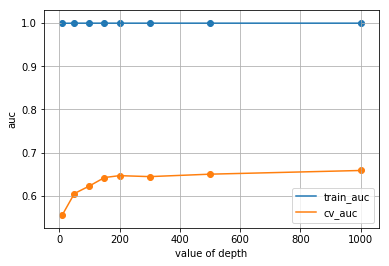

In [77]:
import math
plt.plot(n_estimators,train_auc,label='train_auc')
plt.plot(n_estimators,cv_auc,label='cv_auc')
plt.legend()
plt.scatter(n_estimators,train_auc)
plt.scatter(n_estimators,cv_auc)
plt.grid()
plt.ylabel('auc')
plt.xlabel('value of depth')
plt.show()


In [33]:
parameter = {'n_estimators' : [50,100,500,1000], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=RandomForestClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

4


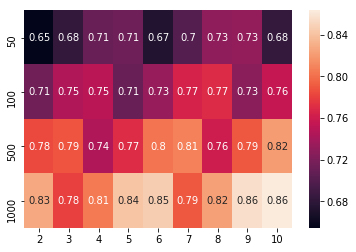

In [49]:
n_estimators=[50,100,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))

print(len(train_auc))
sns.heatmap(train_auc,annot=True,xticklabels=[2, 3, 4, 5, 6, 7, 8, 9, 10],yticklabels=[50,100,500,1000])

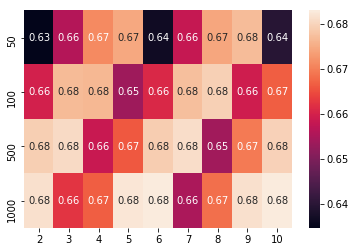

In [50]:
n_estimators=[50,100,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_auc,annot=True,xticklabels=[2, 3, 4, 5, 6, 7, 8, 9, 10],yticklabels=[50,100,500,1000])

In [104]:
est = [10,50,100,150,200,300,500,1000]
max_depth = []
for i in range(2,11):
    for e in range(8):
        max_depth.append(i)
estimator=[]
for i in range(9):
    for e in est:
        estimator.append(e)

In [57]:
%matplotlib inline
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
import numpy as np

In [58]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [108]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [88]:
Gridcv.best_params_

{'max_depth': 10, 'n_estimators': 1000}

In [94]:
model=RandomForestClassifier(max_depth = 10, n_estimators = 1000)
model.fit(train_bow,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_bow.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_bow[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_bow.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_bow[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:26<00:00,  1.33it/s]


Text(0,0.5,'True positive rate')

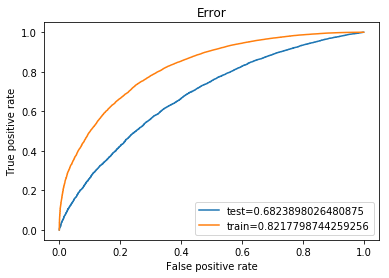

In [96]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

In [139]:
print(thresholds_test.shape)

(8209,)


In [94]:
def predict(proba, threshould, fpr, tpr):
    t = threshould[np.argmax(fpr*(1-tpr))]
    # (tpr*(1-fpr)) will be maximum if your fpr is very low and tpr is very high        
    print("the maximum value of tpr*(1-fpr)", max(tpr*(1-fpr)), "for threshold",t)    
    predictions = []    
    for i in proba:        
        if i>=t:            
            predictions.append(1)       
        else:           
            predictions.append(0)
    return predictions


Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.5491490459386578 for threshold 0.8461764906110893
[[ 8882  2598]
 [19751 45240]]
the maximum value of tpr*(1-fpr) 0.5491490459386578 for threshold 0.8461764906110893


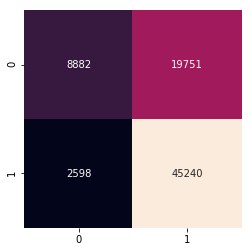

In [113]:
# Please write all the code with proper documentation
print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.4026591982853723 for threshold 0.8469589390226411
[[ 3150  1912]
 [ 9951 17761]]
the maximum value of tpr*(1-fpr) 0.4026591982853723 for threshold 0.8469589390226411


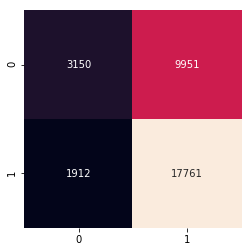

In [116]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.4.2 Applying Random Forests on TFIDF,<font color='red'> SET 2</font>

In [81]:

from scipy.sparse import hstack
train_tfidf=hstack((state_pos_train,state_neg_train,grade_pos_train,grade_neg_train,cat_pos_train,cat_neg_train,prefix_pos_train\
                 ,prefix_neg_train,subcat_pos_train,subcat_neg_train,price_one_hot_train,quantity_one_hot_train,\
                  num_or_not_train,essay_count_train,title_count_train,\
                 tfidf_train_essay,tfidf_train_title)).tocsr()
test_tfidf=hstack((state_pos_test,state_neg_test,grade_pos_test,grade_neg_test,cat_pos_test,cat_neg_test,prefix_pos_test\
                 ,prefix_neg_test,subcat_pos_test,subcat_neg_test,price_one_hot_test,quantity_one_hot_test,\
                  num_or_not_test,essay_count_test,title_count_test,\
                 tfidf_test_essay,tfidf_test_title)).tocsr()

print(train_tfidf.shape)
print(test_tfidf.shape)


(76471, 17176)
(32774, 17176)


In [51]:
from scipy import sparse
train_tfidf = sparse.load_npz("train_tfidf.npz")
test_tfidf= sparse.load_npz("test_tfidf.npz")
cv_tfidf = sparse.load_npz("cv_tfidf.npz")

In [52]:
parameter = {'n_estimators' : [ 50, 100, 200, 500, 1000], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=RandomForestClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_tfidf,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [53]:
Gridcv.best_params_

{'max_depth': 10, 'n_estimators': 1000}

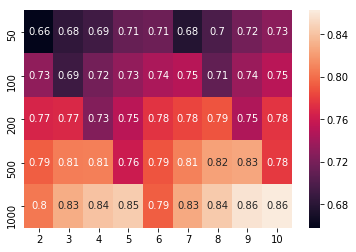

In [54]:
n_estimators=[50,100,200,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

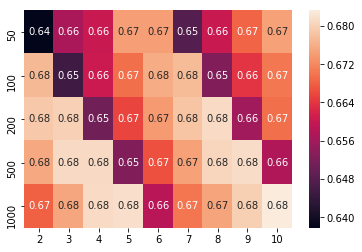

In [55]:
n_estimators=[50,100,200,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
test_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(test_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [111]:
train_auc=[]
cv_auc=[]
n_estimators = [10, 50, 100, 150, 200, 300, 500, 1000]

parameter={'max_depth':[2, 3, 4, 5, 6, 7, 8, 9, 10]}
for K in n_estimators:
    clf=RandomForestClassifier(n_estimators=K)
    Gridcv=GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
    Gridcv.fit(train_tfidf,y_train)
    train_auc.extend(Gridcv.cv_results_['mean_train_score'])
    cv_auc.extend(Gridcv.cv_results_['mean_test_score'])

In [115]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [100]:
train_auc=[]
cv_auc=[]
n_estimators = [10, 50, 100, 150, 200, 300, 500, 1000]
for n in tqdm(n_estimators):
    clf=RandomForestClassifier(n_estimators=n,min_samples_split=10)
    clf.fit(train_tfidf,y_train)
    train_prob=[]
    for i in range(0,train_tfidf.shape[0],1000):
        train_prob.extend(clf.predict_proba(train_tfidf[i:i+1000])[:,1])
    cv_prob=[]
    for i in range(0,cv_tfidf.shape[0],1000):
        cv_prob.extend(clf.predict_proba(cv_tfidf[i:i+1000])[:,1])
    train_auc.append(roc_auc_score(y_train,train_prob))
    cv_auc.append(roc_auc_score(y_cv,cv_prob))

100%|██████████| 8/8 [2:32:06<00:00, 1755.80s/it]


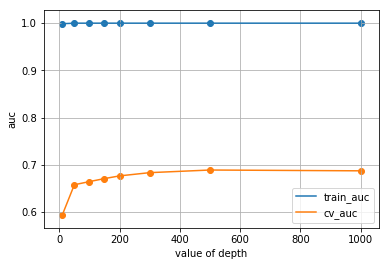

In [102]:
import math
log_N=[math.log(i) for i in n_estimators]
plt.plot(n_estimators,train_auc,label='train_auc')
plt.plot(n_estimators,cv_auc,label='cv_auc')
plt.legend()
plt.scatter(n_estimators,train_auc)
plt.scatter(n_estimators,cv_auc)
plt.grid()
plt.ylabel('auc')
plt.xlabel('value of depth')
plt.show()


In [3]:
from sklearn.ensemble import RandomForestClassifier

In [86]:
best_params={'n_estimators':1000,'max_depth':10}

In [119]:
model=RandomForestClassifier(n_estimators=1000,max_depth=10)
model.fit(train_tfidf,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_tfidf.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_tfidf[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_tfidf.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_tfidf[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:28<00:00,  1.21it/s]


Text(0,0.5,'True positive rate')

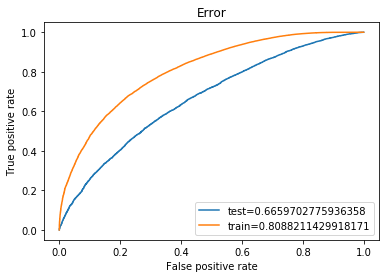

In [120]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.5286170741303928 for threshold 0.8483292005241596
[[ 8491  2989]
 [18747 46244]]
the maximum value of tpr*(1-fpr) 0.5286170741303928 for threshold 0.8483292005241596


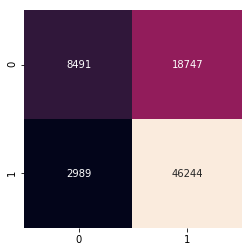

In [123]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.3823896614999412 for threshold 0.8497666505883275
[[ 3059  2003]
 [10321 17391]]
the maximum value of tpr*(1-fpr) 0.3823896614999412 for threshold 0.8497666505883275


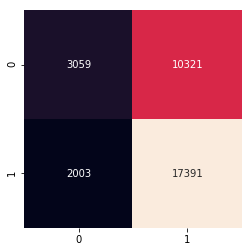

In [124]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.4.3 Applying Random Forests on AVG W2V,<font color='red'> SET 3</font>

In [82]:
from scipy import sparse

In [83]:
avgw2v_train_essay2d=sparse.csr_matrix(avgw2v_train_essay)
avgw2v_train_title2d=sparse.csr_matrix(avgw2v_train_title)

In [84]:
avgw2v_test_essay2d=sparse.csr_matrix(avgw2v_test_essay)
avgw2v_test_title2d=sparse.csr_matrix(avgw2v_test_title)

In [85]:
# Please write all the code with proper documentation
from scipy.sparse import hstack
train_avgw2v=hstack((state_pos_train,state_neg_train,grade_pos_train,grade_neg_train,cat_pos_train,cat_neg_train,prefix_pos_train\
                 ,prefix_neg_train,subcat_pos_train,subcat_neg_train,price_one_hot_train,quantity_one_hot_train,\
                  num_or_not_train,essay_count_train,title_count_train,avgw2v_train_essay2d,avgw2v_train_title2d)).tocsr()
test_avgw2v=hstack((state_pos_test,state_neg_test,grade_pos_test,grade_neg_test,cat_pos_test,cat_neg_test,prefix_pos_test\
                 ,prefix_neg_test,subcat_pos_test,subcat_neg_test,price_one_hot_test,quantity_one_hot_test,\
                  num_or_not_test,essay_count_test,title_count_test,\
                 avgw2v_test_essay2d,avgw2v_test_title2d)).tocsr()

print(train_avgw2v.shape)
print(test_avgw2v.shape)
print(y_train.shape)
print(y_test.shape)

(76471, 615)
(32774, 615)
(76471,)
(32774,)


In [89]:
from scipy import sparse
train_avgw2v = sparse.load_npz("train_avgw2v.npz")
test_avgw2v= sparse.load_npz("test_avgw2v.npz")
cv_avgw2v = sparse.load_npz("cv_avgw2v.npz")

In [90]:
train_avgw2v = train_avgw2v[:10000:]
test_avgw2v= test_avgw2v[:10000,:]
cv_avgw2v =cv_avgw2v[:10000,:]

In [87]:
act_y=y_train[:10000]
act_y.shape

(10000,)

In [88]:
act_y_test=y_test[:10000]
act_y_test.shape

(10000,)

In [61]:
parameter = {'n_estimators' : [ 50, 100, 300, 500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=RandomForestClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_avgw2v,act_y)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [62]:
Gridcv.best_params_

{'max_depth': 4, 'n_estimators': 300}

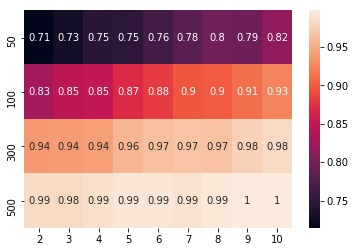

In [64]:
n_estimators=[50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

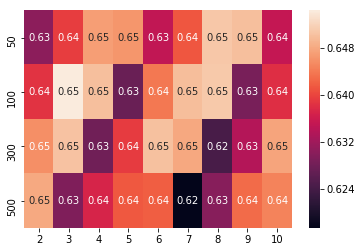

In [66]:
n_estimators=[50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
test_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(test_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [81]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score,auc
from tqdm import tqdm
train_auc=[]
cv_auc=[]
n_estimators = [10, 50, 100, 150, 200, 300, 500]
for n in tqdm(n_estimators):
    clf=RandomForestClassifier(n_estimators=n   
    clf.fit(train_avgw2v,y_train)
    train_prob=[]
    for i in range(0,train_avgw2v.shape[0],1000):
        train_prob.extend(clf.predict_proba(train_avgw2v[i:i+1000])[:,1])
    cv_prob=[]
    for i in range(0,cv_avgw2v.shape[0],1000):
        cv_prob.extend(clf.predict_proba(cv_avgw2v[i:i+1000])[:,1])
    train_auc.append(roc_auc_score(y_train,train_prob))
    cv_auc.append(roc_auc_score(y_cv,cv_prob))

100%|██████████| 8/8 [12:12:11<00:00, 9307.13s/it] 


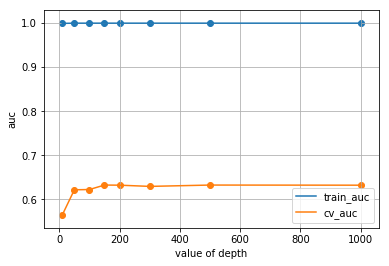

In [82]:
n_estimators = [10, 50, 100, 150, 200, 300, 500,1000]
import math
log_N=[math.log(i) for i in n_estimators]
plt.plot(n_estimators,train_auc,label='train_auc')
plt.plot(n_estimators,cv_auc,label='cv_auc')
plt.legend()
plt.scatter(n_estimators,train_auc)
plt.scatter(n_estimators,cv_auc)
plt.grid()
plt.ylabel('auc')
plt.xlabel('value of depth')
plt.show()


In [129]:
model=RandomForestClassifier(n_estimators=100,max_depth=3)
model.fit(train_avgw2v,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_avgw2v.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_avgw2v[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_avgw2v.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_avgw2v[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:06<00:00,  5.43it/s]


Text(0,0.5,'True positive rate')

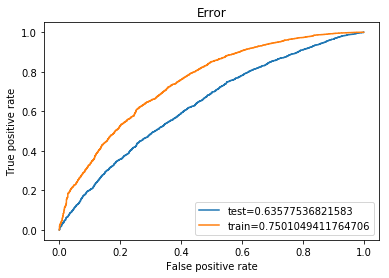

In [77]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.40356520015609776 for threshold 0.8503725056735592
[[ 7884  3596]
 [28108 36883]]
the maximum value of tpr*(1-fpr) 0.40356520015609776 for threshold 0.8503725056735592


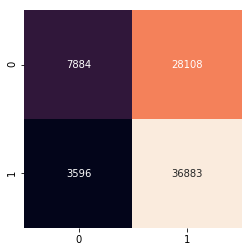

In [130]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.38208446784126254 for threshold 0.8485649846120691
[[ 3182  1880]
 [11018 16694]]
the maximum value of tpr*(1-fpr) 0.38208446784126254 for threshold 0.8485649846120691


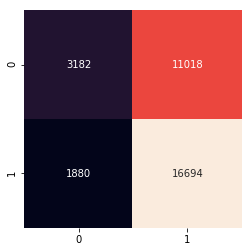

In [131]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.4.4 Applying Random Forests on TFIDF W2V,<font color='red'> SET 4</font>

In [86]:

wtw2v_train_essay2d=sparse.csr_matrix(wtw2v_train_essay)
wtw2v_train_title2d=sparse.csr_matrix(wtw2v_train_title)

In [87]:

wtw2v_test_essay2d=sparse.csr_matrix(wtw2v_test_essay)
wtw2v_test_title2d=sparse.csr_matrix(wtw2v_test_title)

In [88]:

from scipy.sparse import hstack
train_wtw2v=hstack((state_pos_train,state_neg_train,grade_pos_train,grade_neg_train,cat_pos_train,cat_neg_train,prefix_pos_train\
                 ,prefix_neg_train,subcat_pos_train,subcat_neg_train,price_one_hot_train,quantity_one_hot_train,\
                  num_or_not_train,essay_count_train,title_count_train,wtw2v_train_essay2d,wtw2v_train_title2d)).tocsr()
test_wtw2v=hstack((state_pos_test,state_neg_test,grade_pos_test,grade_neg_test,cat_pos_test,cat_neg_test,prefix_pos_test\
                 ,prefix_neg_test,subcat_pos_test,subcat_neg_test,price_one_hot_test,quantity_one_hot_test,\
                  num_or_not_test,essay_count_test,title_count_test,\
                 wtw2v_test_essay2d,wtw2v_test_title2d)).tocsr()

print(train_wtw2v.shape)
print(test_wtw2v.shape)


(76471, 615)
(32774, 615)


In [82]:
from scipy import sparse
train_wtw2v = sparse.load_npz("train_wtw2v.npz")
test_wtw2v= sparse.load_npz("test_wtw2v.npz")
cv_wtw2v = sparse.load_npz("cv_wtw2v.npz")

In [83]:
train_wtw2v=train_wtw2v[:10000,:]
test_wtw2v=test_wtw2v[:10000,:]
cv_wtw2v=cv_wtw2v[:10000,:]

In [84]:
act_y=y_train[:10000]
act_y_test=y_train[:10000]

In [85]:
parameter = {'n_estimators' : [50, 100, 300, 500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=RandomForestClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_wtw2v,act_y)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [87]:
Gridcv.best_params_


{'max_depth': 3, 'n_estimators': 500}

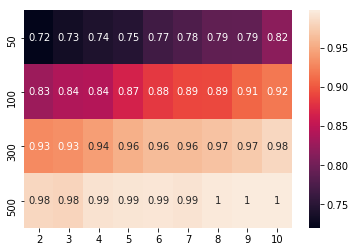

In [88]:
n_estimators=[50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

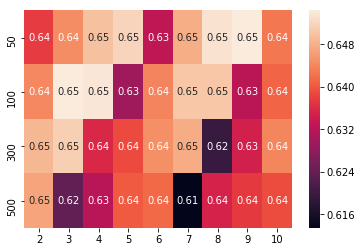

In [89]:
n_estimators=[50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [38]:
est = [10,50,100,150,200,300,500]
max_depth = []
for i in range(2,11):
    for e in range(8):
        max_depth.append(i)
estimator=[]
for i in range(9):
    for e in est:
        estimator.append(e)

In [41]:
train_auc=Gridcv.cv_results_['mean_train_score']
cv_auc=Gridcv.cv_results_['mean_test_score']

In [42]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [136]:
model=RandomForestClassifier(n_estimators=500,max_depth=3)
model.fit(train_wtw2v,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_wtw2v.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_wtw2v[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_wtw2v.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_wtw2v[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:29<00:00,  1.18it/s]


Text(0,0.5,'True positive rate')

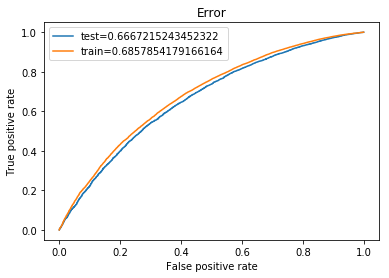

In [137]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.4053282049184296 for threshold 0.8459810160253788
[[ 7527  3953]
 [25029 39962]]
the maximum value of tpr*(1-fpr) 0.4053282049184296 for threshold 0.8459810160253788


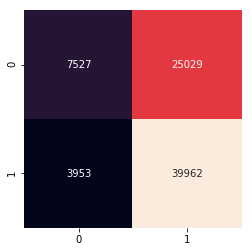

In [138]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.3891800849603485 for threshold 0.8464755694354048
[[ 3268  1794]
 [11152 16560]]
the maximum value of tpr*(1-fpr) 0.3891800849603485 for threshold 0.8464755694354048


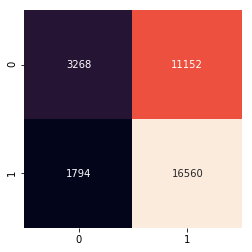

In [139]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.5.1 Applying XGBOOST on BOW,<font color='red'> SET 1</font>

In [141]:
from sklearn.ensemble import GradientBoostingClassifier

In [97]:


from scipy import sparse
train_bow = sparse.load_npz("train_bow.npz")
test_bow= sparse.load_npz("test_bow.npz")
cv_bow = sparse.load_npz("cv_bow.npz")

In [98]:
parameter = {'n_estimators' : [10, 50,100,300,500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [99]:
Gridcv.best_params_

{'max_depth': 3, 'n_estimators': 500}

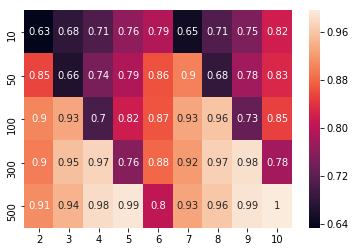

In [100]:
n_estimators=[10,50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

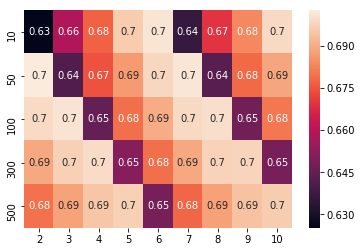

In [101]:
n_estimators=[10,50,100,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [61]:
est = [10,50,100,500]
max_depth = []
for i in range(2,11):
    for e in range(4):
        max_depth.append(i)
estimator=[]
for i in range(9):
    for e in est:
        estimator.append(e)

In [33]:
train_auc=Gridcv.cv_results_['mean_train_score']
cv_auc=Gridcv.cv_results_['mean_test_score']

In [34]:
print(train_auc)
print(cv_auc)

[0.63291774 0.67689931 0.64873534 0.70867593 0.66385918 0.74202809
 0.68184361 0.77862529 0.70318493 0.81559066 0.73008559 0.84919454
 0.75508387 0.87796558 0.77603869 0.90656571 0.80058897 0.92758974]
[0.62516297 0.65900856 0.63627576 0.66943743 0.64153709 0.67436842
 0.64259966 0.67753884 0.64529342 0.6803361  0.64815125 0.68098195
 0.6500195  0.68149272 0.65007131 0.67920776 0.64814151 0.67831724]


In [35]:
parameter = {'n_estimators' : [100], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv1 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv1.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [37]:
Gridcv1.best_params_

{'max_depth': 8, 'n_estimators': 100}

In [41]:
train_auc1=Gridcv1.cv_results_['mean_train_score']
cv_auc1=Gridcv1.cv_results_['mean_test_score']
print(train_auc1)
print(cv_auc1)

[0.70756914 0.74830304 0.78987863 0.82979002 0.8642904  0.89627552
 0.9226512  0.94450646 0.960815  ]
[0.67710793 0.68336113 0.68597199 0.68833795 0.68922387 0.68881155
 0.68925175 0.68872551 0.68730359]


In [39]:
parameter = {'n_estimators' : [500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8,9,10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv2 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv2.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [40]:
Gridcv2.best_params_

{'max_depth': 3, 'n_estimators': 500}

In [42]:
train_auc2=Gridcv2.cv_results_['mean_train_score']
cv_auc2=Gridcv2.cv_results_['mean_test_score']
print(train_auc2)
print(cv_auc2)

[0.79243325 0.85383515 0.90108004 0.93158397 0.95647285 0.97349964
 0.98420754 0.99096915 0.99525099]
[0.70147388 0.70289378 0.70207982 0.70095876 0.69981674 0.69953514
 0.69762899 0.6960454  0.69605659]


In [57]:
train_score=[]
train_score.extend(train_auc)
train_score.extend(train_auc1)
train_score.extend(train_auc2)
cv_score=[]
cv_score.extend(cv_auc)
cv_score.extend(cv_auc1)
cv_score.extend(cv_auc2)

In [66]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_score, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_score, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [43]:
parameter = {'n_estimators' :[50,100], 'max_depth' :[8]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [44]:
Gridcv.best_params_

{'max_depth': 8, 'n_estimators': 100}

In [45]:
parameter = {'n_estimators' :[500,100], 'max_depth' :[8,3]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_bow,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [46]:
Gridcv.best_params_

{'max_depth': 3, 'n_estimators': 500}

In [142]:
model=GradientBoostingClassifier(n_estimators=500,max_depth=3)
model.fit(train_bow,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_bow.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_bow[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_bow.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_bow[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:00<00:00, 54.69it/s]


Text(0,0.5,'True positive rate')

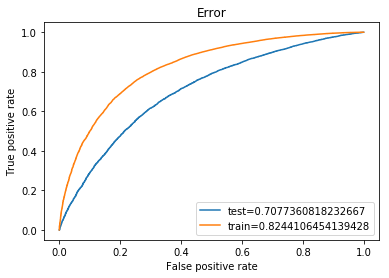

In [143]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.5653992630016796 for threshold 0.8362352527352461
[[ 8787  2693]
 [17380 47611]]
the maximum value of tpr*(1-fpr) 0.5653992630016796 for threshold 0.8362352527352461


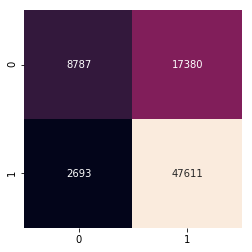

In [144]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.43514711742978296 for threshold 0.850914814716488
[[ 3441  1621]
 [10113 17599]]
the maximum value of tpr*(1-fpr) 0.43514711742978296 for threshold 0.850914814716488


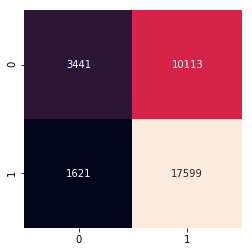

In [145]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.5.2 Applying XGBOOST on TFIDF,<font color='red'> SET 2</font>

In [30]:

from scipy import sparse
train_tfidf = sparse.load_npz("train_tfidf.npz")
test_tfidf= sparse.load_npz("test_tfidf.npz")
cv_tfidf = sparse.load_npz("cv_tfidf.npz")

In [35]:
from sklearn.ensemble import GradientBoostingClassifier

In [32]:
parameter = {'n_estimators' : [50,300,500,1000], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv.fit(train_tfidf,y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [33]:
Gridcv.best_params_

{'max_depth': 2, 'n_estimators': 1000}

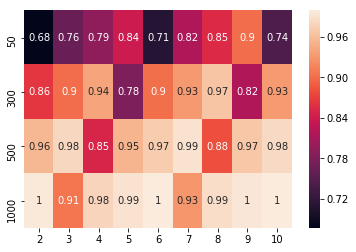

In [34]:
n_estimators=[50,300,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_auc=Gridcv.cv_results_['mean_train_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

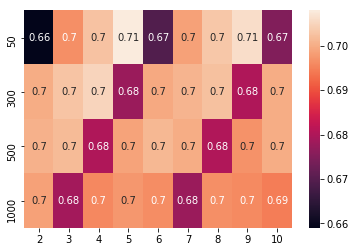

In [35]:
n_estimators=[50,300,500,1000]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_auc=Gridcv.cv_results_['mean_test_score'].reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_auc,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [146]:
model=GradientBoostingClassifier(n_estimators=500,max_depth=3)
model.fit(train_tfidf,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_tfidf.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_tfidf[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_tfidf.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_tfidf[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:00<00:00, 47.00it/s]


Text(0,0.5,'True positive rate')

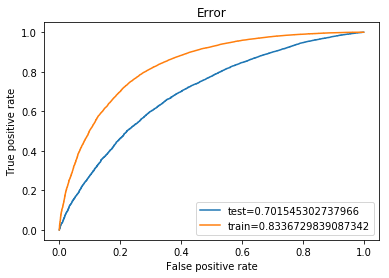

In [147]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.5770624793558926 for threshold 0.8506979685172684
[[ 9192  2288]
 [19596 45395]]
the maximum value of tpr*(1-fpr) 0.5770624793558926 for threshold 0.8506979685172684


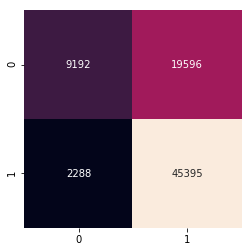

In [148]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.4265435889998659 for threshold 0.8546173687565821
[[ 3358  1704]
 [10042 17670]]
the maximum value of tpr*(1-fpr) 0.4265435889998659 for threshold 0.8546173687565821


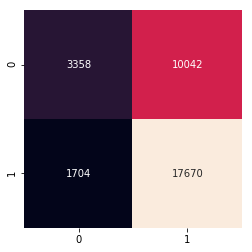

In [149]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.5.3 Applying XGBOOST on AVG W2V,<font color='red'> SET 3</font>

In [30]:

from scipy import sparse
train_avgw2v = sparse.load_npz("train_avgw2v.npz")
test_avgw2v= sparse.load_npz("test_avgw2v.npz")
cv_avgw2v = sparse.load_npz("cv_avgw2v.npz")

In [31]:
train_avgw2v=train_avgw2v[:10000,:]                    # DUE TO Memory Error
test_avgw2v=test_avgw2v[:10000,:]
cv_avgw2v=cv_avgw2v[:10000,:]
train_avgw2v.shape

(10000, 615)

In [32]:
act_y=y_train.iloc[:10000]
act_y.shape

(10000,)

In [33]:
act_y_test=y_test.iloc[:10000]
act_y_test.shape

(10000,)

In [ ]:
parameter = {'n_estimators' : [50,300], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv1 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv1.fit(train_avgw2v,act_y)

In [37]:
parameter = {'n_estimators' : [500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv2 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv2.fit(train_avgw2v,act_y)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [38]:
train_auc1=Gridcv2.cv_results_['mean_train_score']
cv_auc1=Gridcv2.cv_results_['mean_test_score']
train_auc=Gridcv1.cv_results_['mean_train_score']
cv_auc=Gridcv1.cv_results_['mean_test_score']

In [52]:
train_score=[]
cv_score=[]
train_score.extend(train_auc1)
train_score.extend(train_auc)
cv_score.extend(cv_auc1)
cv_score.extend(cv_auc)

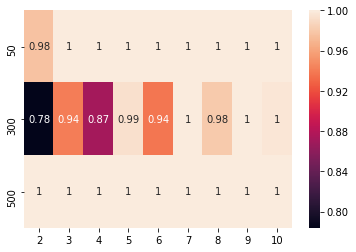

In [56]:
n_estimators=[50,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_area=np.array(train_score).reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_area,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

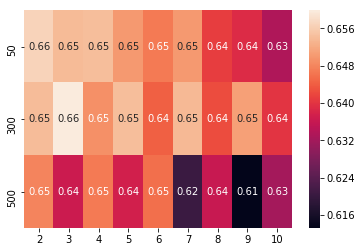

In [57]:
n_estimators=[50,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_area=np.array(cv_score).reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_area,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [55]:
est = [50,100,500]
max_depth = []
for i in range(2,11):
    for e in range(3):
        max_depth.append(i)
estimator=[]
for i in range(9):
    for e in est:
        estimator.append(e)

In [59]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_score, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_score, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [90]:
from sklearn.ensemble import GradientBoostingClassifier

In [91]:
model=GradientBoostingClassifier(n_estimators=300,max_depth=3)
model.fit(train_avgw2v,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_avgw2v.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_avgw2v[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_avgw2v.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_avgw2v[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:01<00:00, 18.15it/s]


Text(0,0.5,'True positive rate')

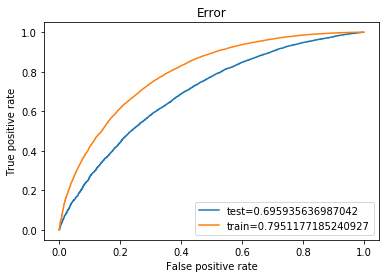

In [92]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.5199988036403004 for threshold 0.853169337385078
[[ 8602  2878]
 [20704 44287]]
the maximum value of tpr*(1-fpr) 0.5199988036403004 for threshold 0.853169337385078


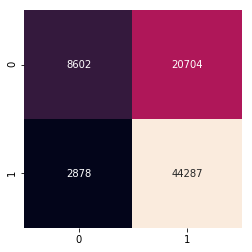

In [95]:

print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.414002968274231 for threshold 0.8591763910221298
[[ 3301  1761]
 [10261 17451]]
the maximum value of tpr*(1-fpr) 0.414002968274231 for threshold 0.8591763910221298


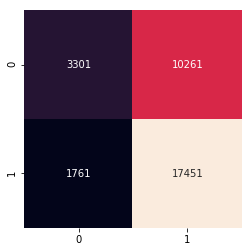

In [96]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

### 2.5.4 Applying XGBOOST on TFIDF W2V,<font color='red'> SET 4</font>

In [31]:

from scipy import sparse
train_wtw2v = sparse.load_npz("train_wtw2v.npz")
test_wtw2v= sparse.load_npz("test_wtw2v.npz")
cv_wtw2v = sparse.load_npz("cv_wtw2v.npz")

In [32]:
train_wtw2v=train_wtw2v[:10000,:]
test_wtw2v=test_wtw2v[:10000,:]                              #Due to Memory Error
cv_wtw2v=cv_wtw2v[:10000,:]
train_wtw2v.shape

(10000, 615)

In [33]:
act_y=y_train[:10000]
act_y_test=y_test[:10000]
print(act_y.shape)
print(act_y_test.shape)

(10000,)
(10000,)


In [36]:
parameter = {'n_estimators' : [50,100], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv2 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv2.fit(train_wtw2v,act_y)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [72]:
import scipy
train_auc=Gridcv2.cv_results_['mean_train_score']
cv_auc=Gridcv2.cv_results_['mean_test_score']
train_auc = scipy.sparse.csc_matrix(np.array(train_auc))
scipy.sparse.save_npz('train_auc.npz', train_auc)
cv_auc=scipy.sparse.csc_matrix(np.array(cv_auc))
scipy.sparse.save_npz('cv_auc.npz',cv_auc)

In [40]:
parameter = {'n_estimators' : [500], 'max_depth' : [2, 3, 4, 5, 6, 7, 8, 9, 10]}
from sklearn.model_selection import GridSearchCV
clf=GradientBoostingClassifier()
Gridcv1 = GridSearchCV(clf,parameter,cv=3,scoring='roc_auc',return_train_score=True)
Gridcv1.fit(train_wtw2v,act_y)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=GradientBoostingClassifier(criterion='friedman_mse',
                                                  init=None, learning_rate=0.1,
                                                  loss='deviance', max_depth=3,
                                                  max_features=None,
                                                  max_leaf_nodes=None,
                                                  min_impurity_decrease=0.0,
                                                  min_impurity_split=None,
                                                  min_samples_leaf=1,
                                                  min_samples_split=2,
                                                  min_weight_fraction_leaf=0.0,
                                                  n_estimators=100,
                                                  n_iter_no_change=None,
                                                  presort=

In [75]:
train_auc1=Gridcv1.cv_results_['mean_train_score']
cv_auc1=Gridcv1.cv_results_['mean_test_score']

In [76]:
train_auc=Gridcv2.cv_results_['mean_train_score']
cv_auc=Gridcv2.cv_results_['mean_test_score']

In [92]:
train_score=[]
cv_score=[]
train_score.extend(train_auc)
train_score.extend(train_auc1)
cv_score.extend(cv_auc)
cv_score.extend(cv_auc1)


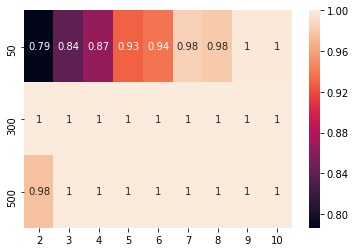

In [78]:
n_estimators=[50,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
train_area=np.array(train_score).reshape(len(n_estimators),len(max_depth))
sns.heatmap(train_area,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

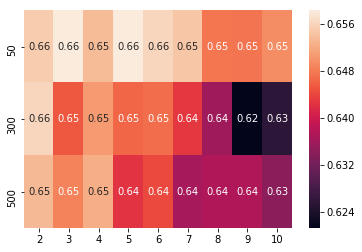

In [79]:
n_estimators=[50,300,500]
max_depth= [2, 3, 4, 5, 6, 7, 8, 9, 10]
cv_area=np.array(cv_score).reshape(len(n_estimators),len(max_depth))
sns.heatmap(cv_area,annot=True,xticklabels=max_depth,yticklabels=n_estimators)

In [92]:
est = [50,100,500]
max_depth = []
for i in range(2,11):
    for e in range(3):
        max_depth.append(i)
estimator=[]
for i in range(9):
    for e in est:
        estimator.append(e)

In [93]:
trace1 = go.Scatter3d(x=estimator,y=max_depth,z=train_score, name = 'train')
trace2 = go.Scatter3d(x=estimator,y=max_depth,z=cv_score, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='n_estimators'),
        yaxis = dict(title='max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

In [97]:
model=GradientBoostingClassifier(n_estimators=50,max_depth=5)
model.fit(train_wtw2v,y_train)
y_train_pred=[]
for i in tqdm(range(0,train_wtw2v.shape[0],1000)):
    y_train_pred.extend(model.predict_proba(train_wtw2v[i:i+1000])[:,1])
fpr_train,tpr_train,thresholds_train=roc_curve(y_train,y_train_pred)
y_test_pred=[]
for i in tqdm(range(0,test_wtw2v.shape[0],1000)):
    y_test_pred.extend(model.predict_proba(test_wtw2v[i:i+1000])[:,1])
fpr_test,tpr_test,thresholds_test=roc_curve(y_test,y_test_pred)

100%|██████████| 33/33 [00:02<00:00, 13.22it/s]


Text(0,0.5,'True positive rate')

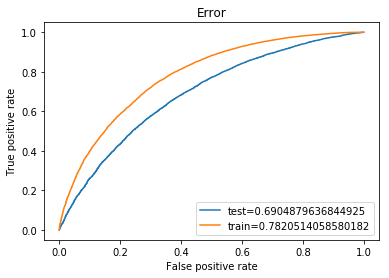

In [98]:
plt.title('Error')
plt.plot(fpr_test,tpr_test,label='test='+str(auc(fpr_test,tpr_test)))
plt.plot(fpr_train,tpr_train,label='train='+str(auc(fpr_train,tpr_train)))
plt.legend()
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')

Train Confusion Matrix
the maximum value of tpr*(1-fpr) 0.506102071114966 for threshold 0.8558194953549505
[[ 8609  2871]
 [22478 42513]]
the maximum value of tpr*(1-fpr) 0.506102071114966 for threshold 0.8558194953549505


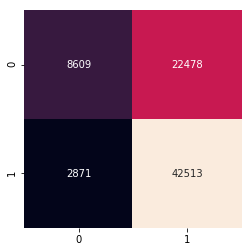

In [99]:
# Please write all the code with proper documentation
print('Train Confusion Matrix')
print(confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)))
tn,fp,fn,tp=confusion_matrix(y_train,predict(y_train_pred,thresholds_train,fpr_train,tpr_train)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

Test Confusion Matrix
the maximum value of tpr*(1-fpr) 0.4131741791508162 for threshold 0.8567504438500495
[[ 3341  1721]
 [10570 17142]]
the maximum value of tpr*(1-fpr) 0.4131741791508162 for threshold 0.8567504438500495


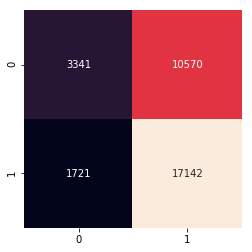

In [100]:
print('Test Confusion Matrix')
print(confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)))
tn,fp,fn,tp=confusion_matrix(y_test,predict(y_test_pred,thresholds_test,fpr_test,tpr_test)).ravel()
mat=np.matrix([[tn,fn],[fp,tp]])
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=False,            
xticklabels=[0,1], yticklabels=[0,1]) 

<h1>3. Conclusion</h1>

In [84]:
from prettytable import PrettyTable
table = PrettyTable()
table.field_names=['Set',"n_estimator","max_depth","auc"]
table.add_row(['BOW','1000','10','0.68'])
table.add_row(['Tfidf','1000','10','0.68'])
table.add_row(['Avgw2v','500','3','0.63'])
table.add_row(['Tfidfw2v','500','3','0.49'])
print("Random Forest")
print(table)
table1=PrettyTable()
table1.field_names=['Set',"n_estimator","max_depth","auc"]
table1.add_row(['BOW','500','3','0.70'])
table1.add_row(['Tfidf','500','3','0.70'])
table1.add_row(['Avgw2v','500','4','0.69'])
table1.add_row(['Tfidfw2v','50','5','0.69'])
print("Gradient Boosted Decision Tree")
print(table1)

Random Forest
+----------+-------------+-----------+------+
|   Set    | n_estimator | max_depth | auc  |
+----------+-------------+-----------+------+
|   BOW    |     1000    |     10    | 0.68 |
|  Tfidf   |     1000    |     10    | 0.68 |
|  Avgw2v  |     500     |     3     | 0.63 |
| Tfidfw2v |     500     |     3     | 0.49 |
+----------+-------------+-----------+------+
Gradient Boosted Decision Tree
+----------+-------------+-----------+------+
|   Set    | n_estimator | max_depth | auc  |
+----------+-------------+-----------+------+
|   BOW    |     500     |     3     | 0.70 |
|  Tfidf   |     500     |     3     | 0.70 |
|  Avgw2v  |     500     |     4     | 0.65 |
| Tfidfw2v |      50     |     5     | 0.65 |
+----------+-------------+-----------+------+
